<a href="https://colab.research.google.com/github/rubbervduck/MRIG/blob/main/notebooks/inference-with-meta-sam-and-sam2-using-ultralytics-python-package.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Setup

Pip install `ultralytics` and [dependencies](https://github.com/ultralytics/ultralytics/blob/main/pyproject.toml) and check software and hardware.

[![PyPI - Version](https://img.shields.io/pypi/v/ultralytics?logo=pypi&logoColor=white)](https://pypi.org/project/ultralytics/) [![Downloads](https://static.pepy.tech/badge/ultralytics)](https://www.pepy.tech/projects/ultralytics) [![PyPI - Python Version](https://img.shields.io/pypi/pyversions/ultralytics?logo=python&logoColor=gold)](https://pypi.org/project/ultralytics/)

In [1]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.1/112.6 GB disk)


## Segment Everything

Using SAM and SAM2 models, you can [segment](https://docs.ultralytics.com/tasks/segment/) the entire image or video content without specific prompts.

In [ ]:
!unzip /content/UFID_Hyd-20250307T084157Z-001.zip -d /content/new


Model summary: 403 layers, 80,850,178 parameters, 80,850,178 gradients

image 1/1 /content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 8161.8ms
Speed: 16.8ms preprocess, 8161.8ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


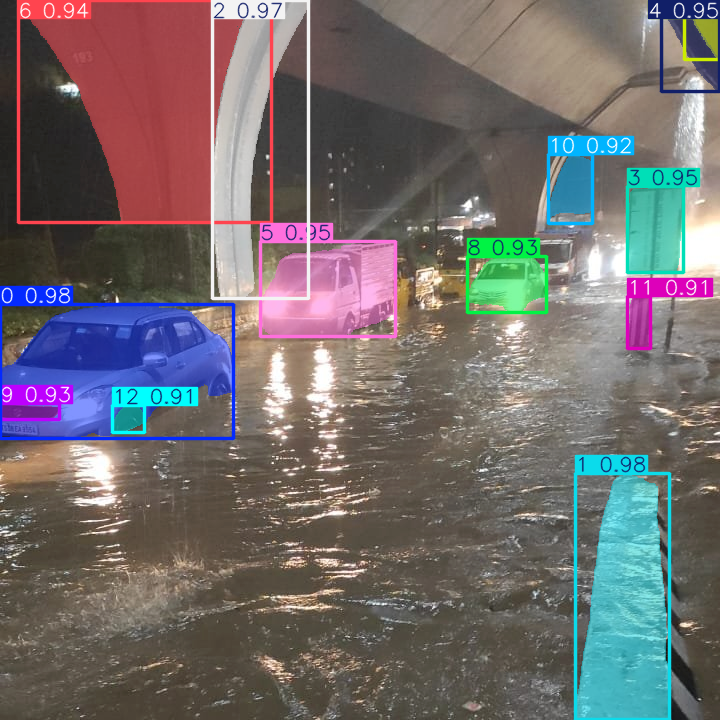

In [5]:
from ultralytics import SAM

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

model.info()  # Display model information (optional)

# Define the path to your local image
image_path = "/content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg"  # Change this to your image path

# Run inference on the local image
results = model(image_path)

# Display the results
results[0].show()


## Segment Anything

You can [segment](https://docs.ultralytics.com/tasks/segment/) specific objects in an image or video using different prompts, such as bounding box and point prompts.

### Bounding box prompt

The `bbox_prompt` refers to a bounding box input that guides the model in segmenting a specific object within an image. In the example below, you will segment only the bus by providing the bounding box coordinates.


image 1/1 /content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 8411.0ms
Speed: 7.0ms preprocess, 8411.0ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


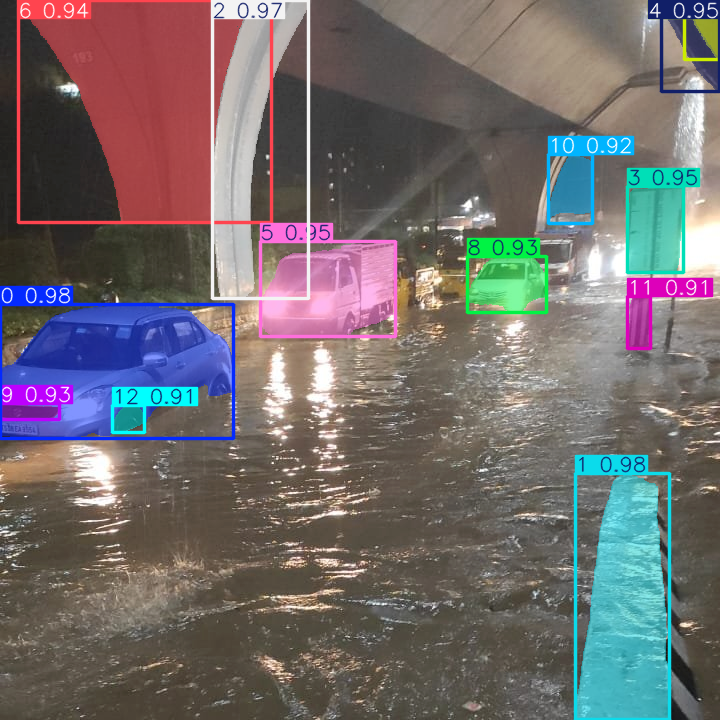

In [7]:
from ultralytics import SAM

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

# Define the path to your local image
image_path = "/content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg"  # Change this to your image path

# Run inference without prompts (segments everything in the image)
results = model(image_path)

# Display the segmented results
results[0].show()


## Working

### Point prompt

The `point_prompt` refers to a specific point input (x, y) that guides the Segment Anything Model (SAM) in segmenting an object within an image. Instead of providing a bounding box, you can indicate an object by selecting a point on it, and SAM will generate a segmentation mask around that point.

In [19]:
!zip -r /content/selected_images.zip /content/selected_images

  adding: content/selected_images/ (stored 0%)
  adding: content/selected_images/Lakdikapul_Metro_Station_12-10-2020.jpg (deflated 0%)
  adding: content/selected_images/Nampally_RailwayStation_09-10-2020.jpg (deflated 6%)
  adding: content/selected_images/ChitraDargha_13-10-2020.jpg (deflated 6%)
  adding: content/selected_images/BanjaraHills_13to14-10-2020.jpg (deflated 0%)
  adding: content/selected_images/Khairatabad_RajivGandhiStatue_13-10-2020.jpg (deflated 1%)
  adding: content/selected_images/Hotel_Marjaan_VijayaNagarColony_Nampally_09-10-2020.jpg (deflated 0%)
  adding: content/selected_images/Puranapool_Graveyard_13-10-2020.jpg (deflated 4%)
  adding: content/selected_images/PetrolPump_OppRajivGandhiStatue_Khairatabad_Saifabad_09-10-2020.jpg (deflated 0%)
  adding: content/selected_images/MozzamjahiMarket_09-10-2020.jpg (deflated 0%)
  adding: content/selected_images/Allugaddabhavi_RailwayUnderBridge_Mettuguda_13-10-2020.jpg (deflated 7%)
  adding: content/selected_images/Mala


image 1/1 /content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg: 1024x1024 1 0, 315.2ms
Speed: 7.6ms preprocess, 315.2ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


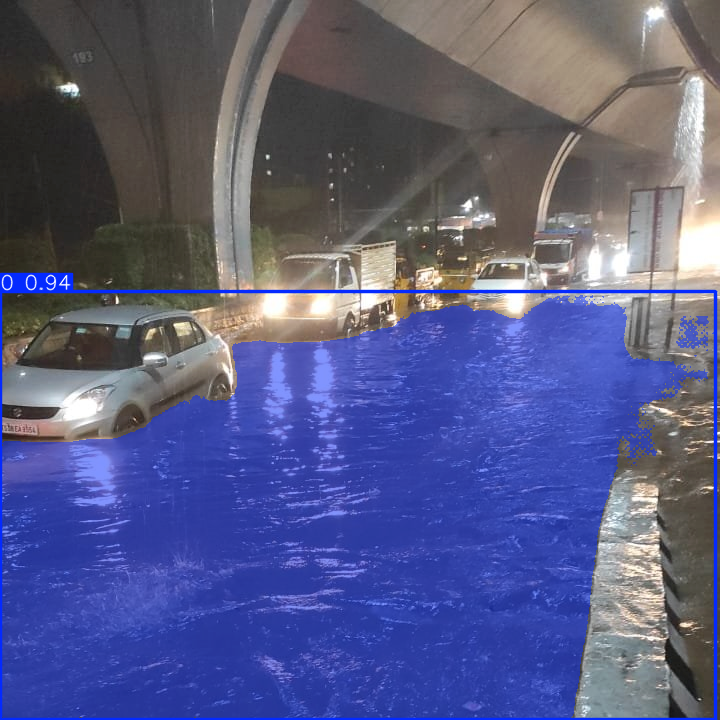

In [10]:
from ultralytics import SAM
import os

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

# Define the path to your local image
image_path = "/content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg"  # Change this to your image path


# Define the point prompt (x, y) for object segmentation
point_prompt = [[450, 500]]  # Adjust coordinates based on your object of interest

# Run inference with the point prompt
results = model(image_path, points=point_prompt)

# Display the segmented results
results[0].show()



image 1/1 /content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg: 1024x1024 1 0, 355.1ms
Speed: 6.1ms preprocess, 355.1ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


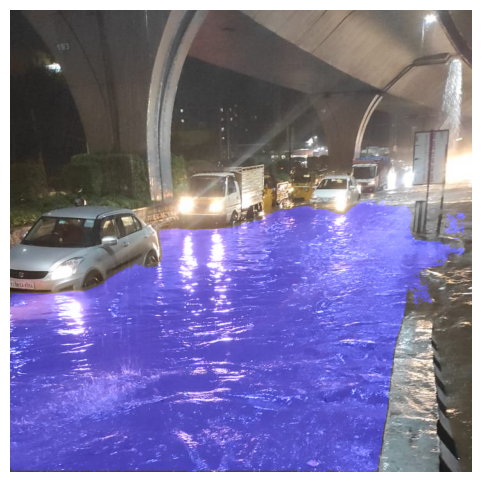

In [13]:
from ultralytics import SAM
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

# Define the path to your local image
image_path = "/content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg"  # Change this to your image path

# Define the point prompt (x, y) for object segmentation
point_prompt = [[400, 500]]  # Adjust coordinates based on your object of interest

# Run inference with the point prompt
results = model(image_path, points=point_prompt)

# Load the original image
original_image = np.array(Image.open(image_path).convert("RGB"))

# Extract the segmentation mask
mask = results[0].masks.data[0].cpu().numpy()  # Get the mask data

# Convert mask to 3 channels (RGB) and scale values
mask_colored = np.zeros_like(original_image)
mask_colored[:, :, 2] = (mask * 255).astype(np.uint8)  # Apply green color for segmentation mask

# Blend the mask with the original image (No Bounding Box)
alpha = 0.5  # Transparency factor
overlay = cv2.addWeighted(original_image, 1, mask_colored, alpha, 0)

# Display the overlaid image without bounding box
plt.figure(figsize=(8, 6))
plt.imshow(overlay)
plt.axis("off")  # Hide axes
plt.show()



image 1/1 /content/UFID_Hyd/BadeMiyanKababs_Restaurant_Lakdikapul_13-10-2020.jpg: 1024x1024 1 0, 336.2ms
Speed: 5.9ms preprocess, 336.2ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


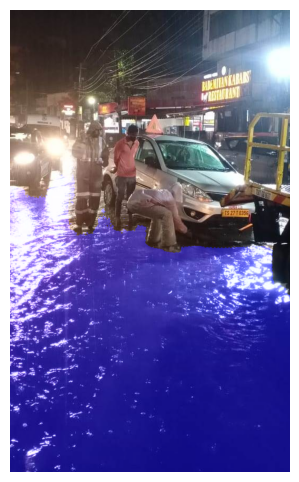

In [15]:
from ultralytics import SAM
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

# Define the path to your local image
image_path = "/content/UFID_Hyd/BadeMiyanKababs_Restaurant_Lakdikapul_13-10-2020.jpg"  # Change this to your image path

# Define the point prompt (x, y) for object segmentation
point_prompt = [[400, 500]]  # Adjust coordinates based on your object of interest

# Run inference with the point prompt
results = model(image_path, points=point_prompt)

# Load the original image
original_image = np.array(Image.open(image_path).convert("RGB"))

# Extract the segmentation mask
mask = results[0].masks.data[0].cpu().numpy()  # Get the mask data

# Convert mask to 3 channels (RGB) and scale values
mask_colored = np.zeros_like(original_image)
mask_colored[:, :, 2] = (mask * 255).astype(np.uint8)  # Blue mask
 # Apply green color for segmentation mask

# Blend the mask with the original image (No Bounding Box)
alpha = 0.5  # Transparency factor
overlay = cv2.addWeighted(original_image, 1, mask_colored, alpha, 0)

# Display the overlaid image without bounding box
plt.figure(figsize=(8, 6))
plt.imshow(overlay)
plt.axis("off")  # Hide axes
plt.show()



image 1/1 /content/UFID_Hyd/Lakdikapul_Metro_Station_12-10-2020.jpg: 1024x1024 1 0, 327.4ms
Speed: 6.5ms preprocess, 327.4ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


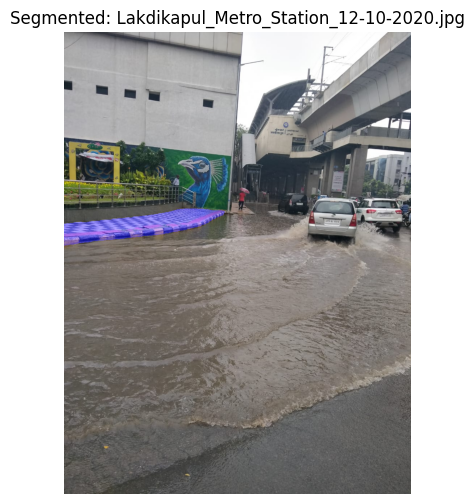


image 1/1 /content/UFID_Hyd/AndhraBank_Shamsheergunj_Falaknuma_13-10-2020.jpg: 1024x1024 1 0, 276.8ms
Speed: 8.6ms preprocess, 276.8ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


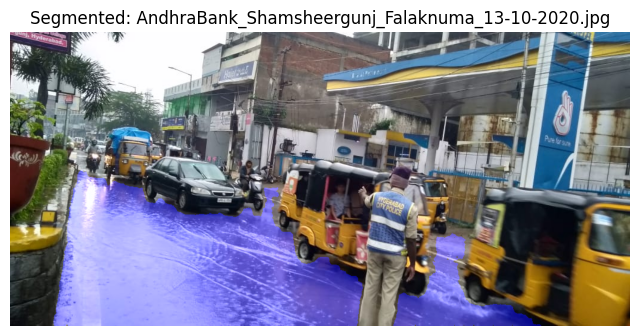


image 1/1 /content/UFID_Hyd/SingareniColony_SaroorNagar _13to14-10-2020.jpg: 1024x1024 1 0, 269.9ms
Speed: 10.5ms preprocess, 269.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


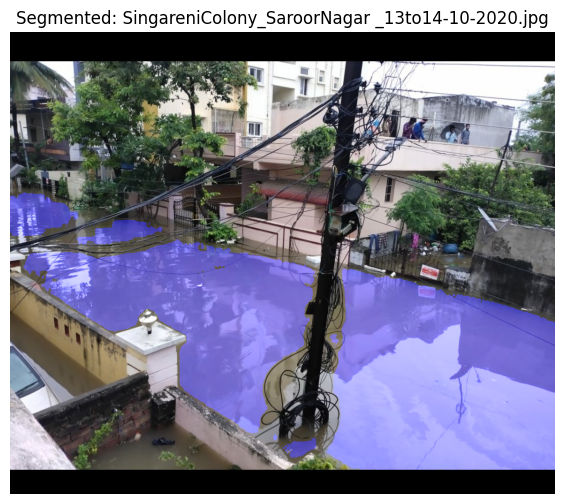


image 1/1 /content/UFID_Hyd/ChitraDhargha_09-10-2020.jpg: 1024x1024 1 0, 270.8ms
Speed: 10.0ms preprocess, 270.8ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


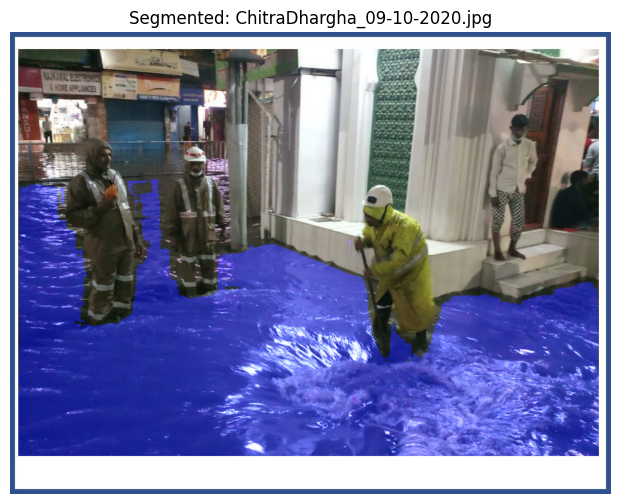


image 1/1 /content/UFID_Hyd/EngineersCADDCenter_2_Ameerpet_09-10-2020.jpg: 1024x1024 1 0, 270.6ms
Speed: 11.0ms preprocess, 270.6ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


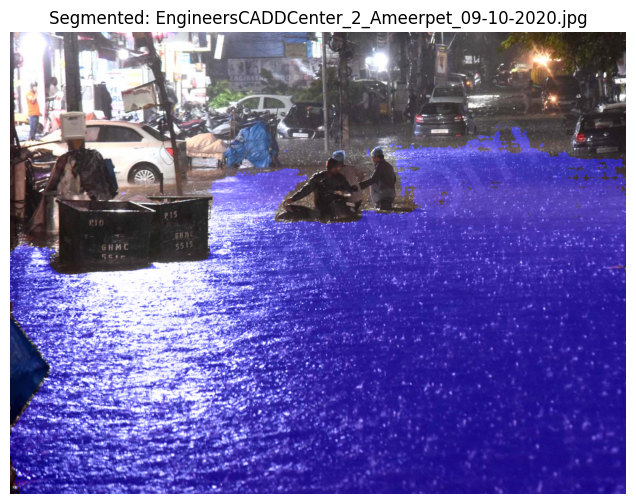


image 1/1 /content/UFID_Hyd/Nampally_RailwayStation_09-10-2020.jpg: 1024x1024 1 0, 270.7ms
Speed: 9.5ms preprocess, 270.7ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


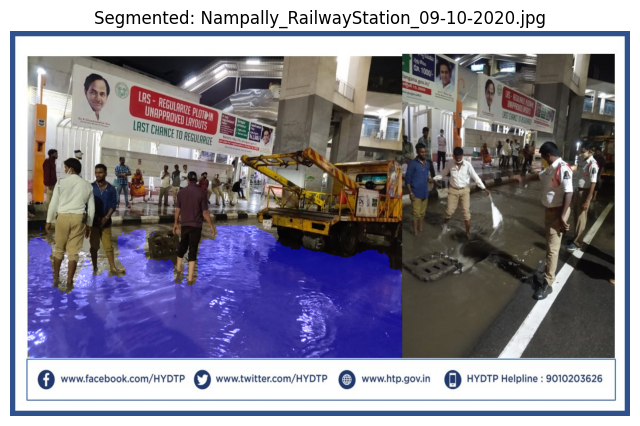


image 1/1 /content/UFID_Hyd/ChitraDargha_13-10-2020.jpg: 1024x1024 1 0, 269.9ms
Speed: 9.2ms preprocess, 269.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


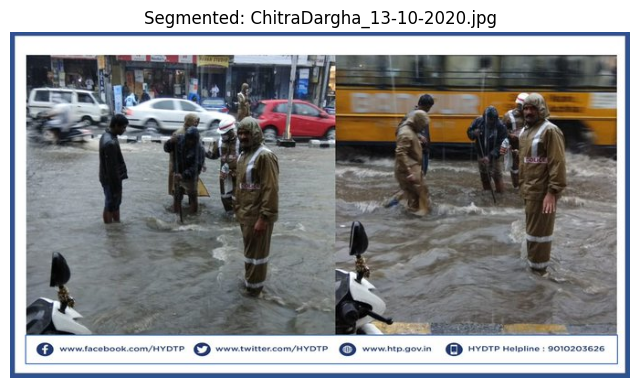


image 1/1 /content/UFID_Hyd/EngineersCADDCenter_Ameerpet_09-10-2020.jpg: 1024x1024 1 0, 272.1ms
Speed: 10.0ms preprocess, 272.1ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


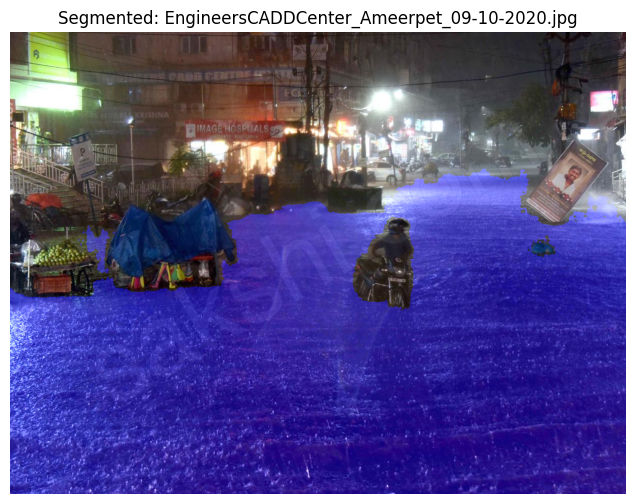


image 1/1 /content/UFID_Hyd/Brahmanwadi_Begumpet_Lane_Number7_13-10-2020.jpg: 1024x1024 1 0, 272.8ms
Speed: 10.4ms preprocess, 272.8ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


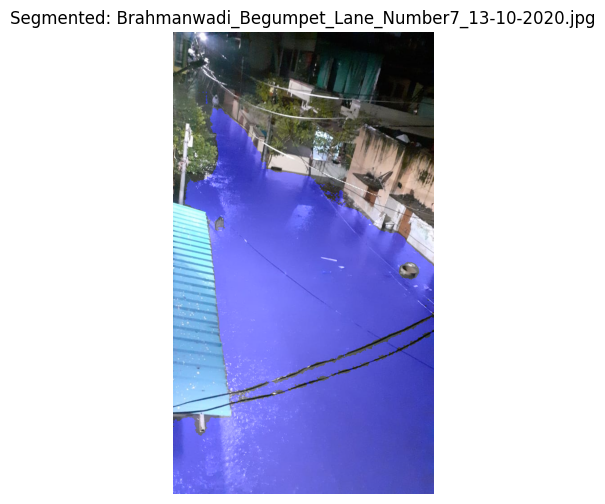


image 1/1 /content/UFID_Hyd/BanjaraHills_13to14-10-2020.jpg: 1024x1024 1 0, 271.3ms
Speed: 6.8ms preprocess, 271.3ms inference, 1.3ms postprocess per image at shape (1, 3, 1024, 1024)


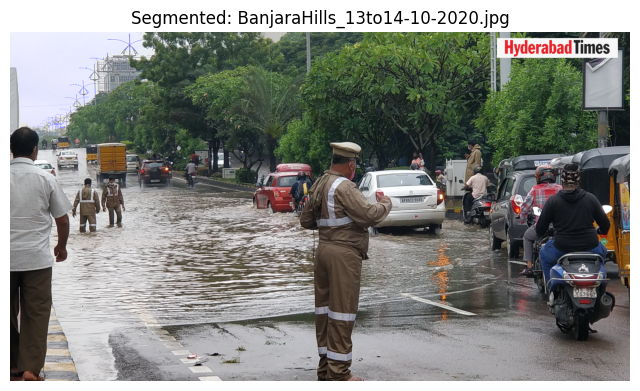


image 1/1 /content/UFID_Hyd/ChitraDhargha_09-10-2020_2.jpg: 1024x1024 1 0, 294.9ms
Speed: 10.5ms preprocess, 294.9ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


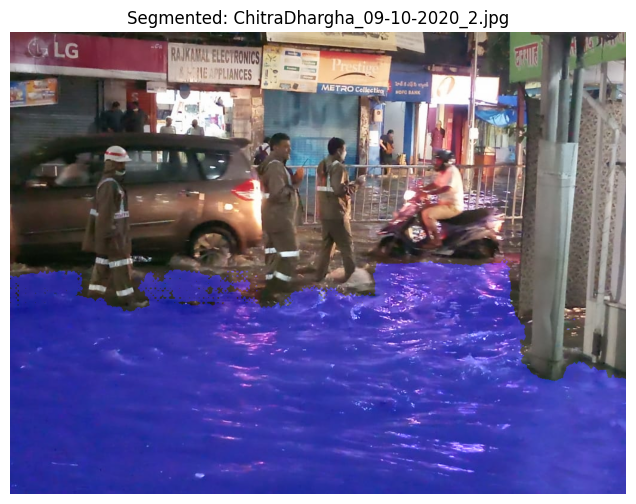


image 1/1 /content/UFID_Hyd/Khairatabad_RajivGandhiStatue_13-10-2020.jpg: 1024x1024 1 0, 287.8ms
Speed: 10.5ms preprocess, 287.8ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


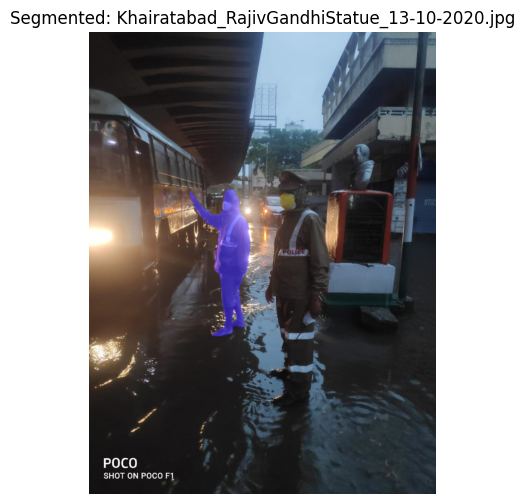


image 1/1 /content/UFID_Hyd/AyodhyaJunction_Khairatabad_12-10-2020.jpg: 1024x1024 1 0, 284.5ms
Speed: 9.3ms preprocess, 284.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


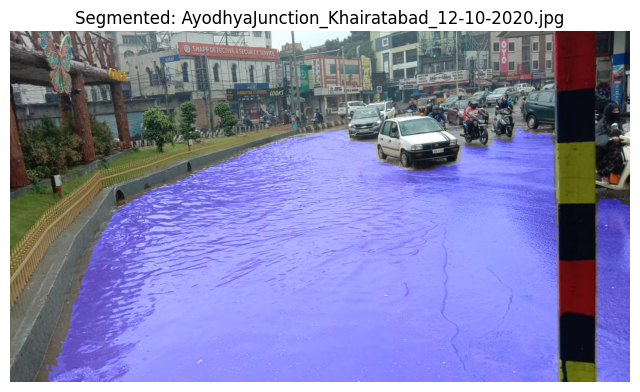


image 1/1 /content/UFID_Hyd/Hotel_Marjaan_VijayaNagarColony_Nampally_09-10-2020.jpg: 1024x1024 1 0, 286.5ms
Speed: 10.2ms preprocess, 286.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


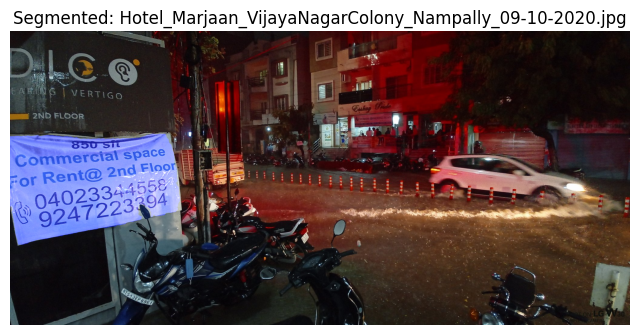


image 1/1 /content/UFID_Hyd/Puranapool_Graveyard_13-10-2020.jpg: 1024x1024 1 0, 277.7ms
Speed: 14.1ms preprocess, 277.7ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


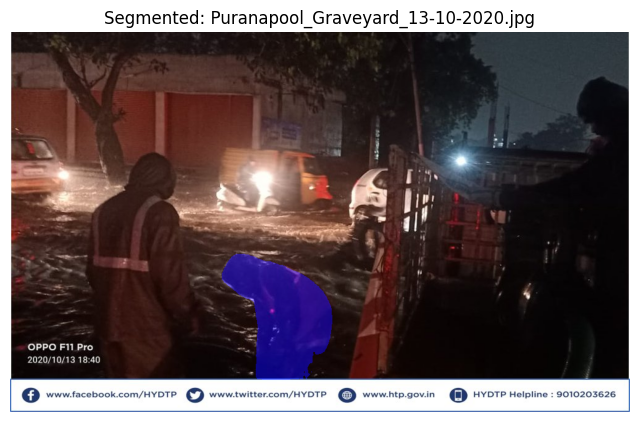


image 1/1 /content/UFID_Hyd/VirasathNagar_Towlichowki_09-10-2020_1.jpg: 1024x1024 1 0, 297.3ms
Speed: 43.2ms preprocess, 297.3ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


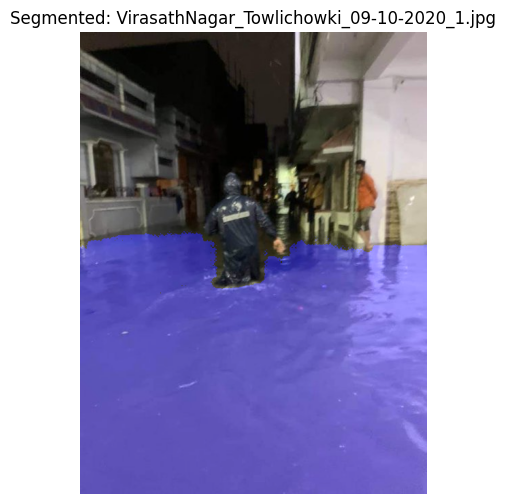


image 1/1 /content/UFID_Hyd/PetrolPump_OppRajivGandhiStatue_Khairatabad_Saifabad_09-10-2020.jpg: 1024x1024 1 0, 289.0ms
Speed: 10.5ms preprocess, 289.0ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


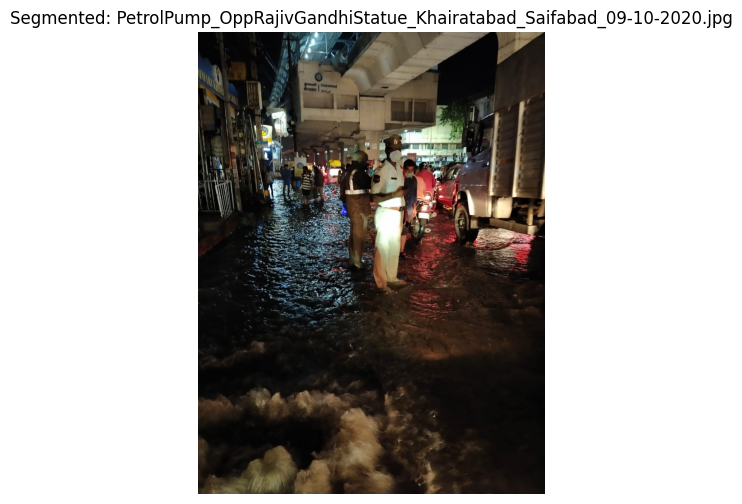


image 1/1 /content/UFID_Hyd/Khairatabad_Railway_Gate_12-10-2020.jpg: 1024x1024 1 0, 370.0ms
Speed: 20.0ms preprocess, 370.0ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


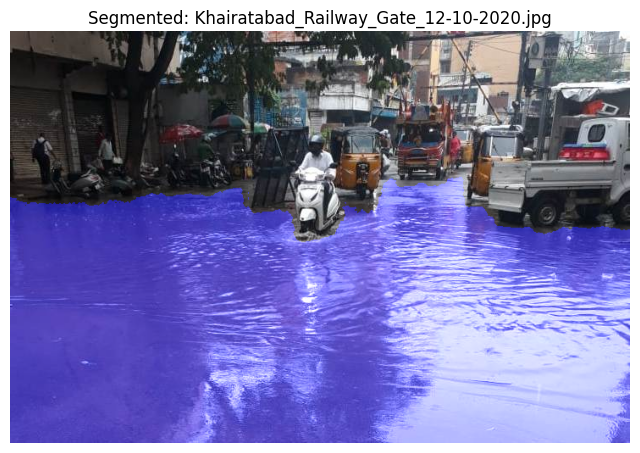


image 1/1 /content/UFID_Hyd/MozzamjahiMarket_09-10-2020.jpg: 1024x1024 1 0, 278.9ms
Speed: 9.7ms preprocess, 278.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


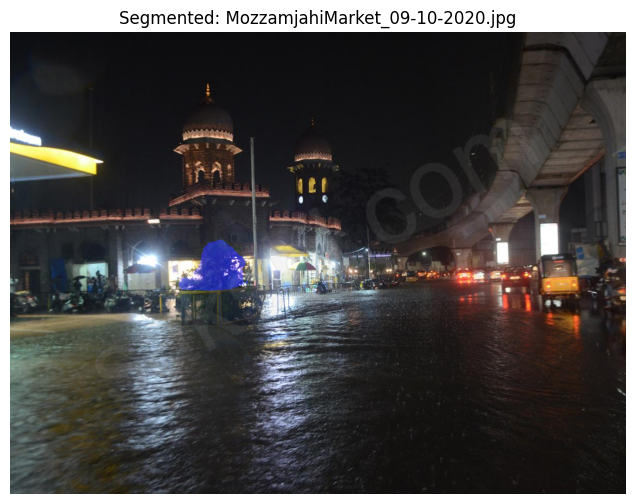


image 1/1 /content/UFID_Hyd/Allugaddabhavi_RailwayUnderBridge_Mettuguda_13-10-2020.jpg: 1024x1024 1 0, 285.5ms
Speed: 11.1ms preprocess, 285.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


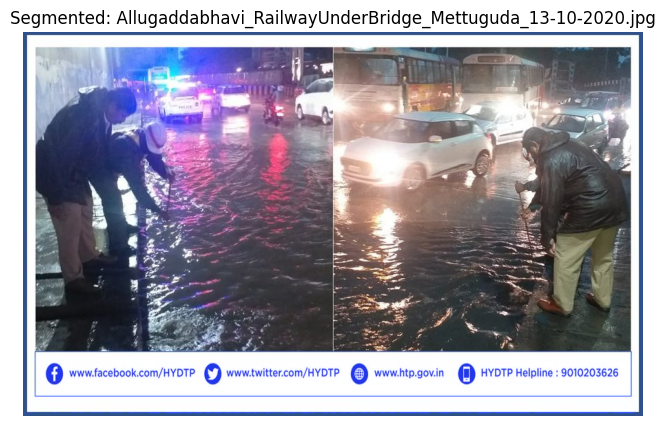


image 1/1 /content/UFID_Hyd/Malakpet_UnderBridge_09-10-2020.jpg: 1024x1024 1 0, 287.7ms
Speed: 11.1ms preprocess, 287.7ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


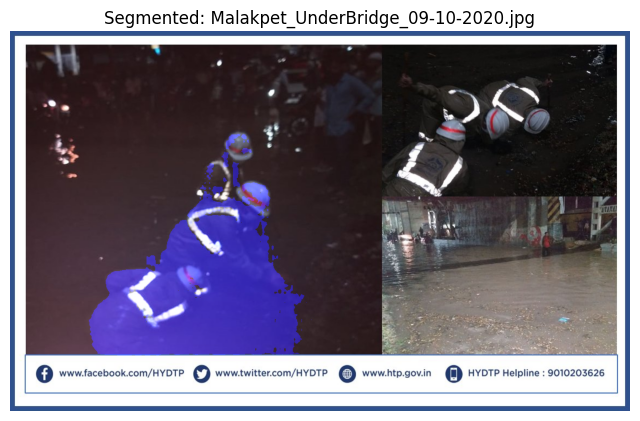


image 1/1 /content/UFID_Hyd/VirasathNagar_Towlichowki_09-10-2020_3.jpg: 1024x1024 1 0, 272.3ms
Speed: 8.8ms preprocess, 272.3ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


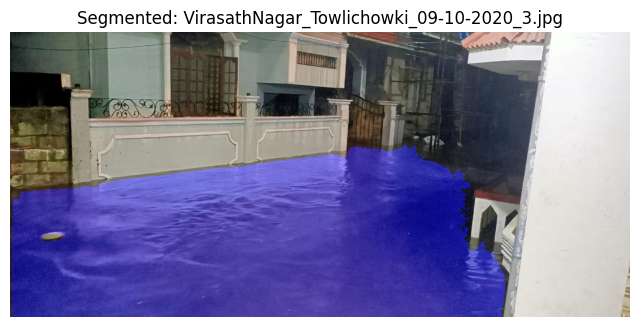


image 1/1 /content/UFID_Hyd/GulzarHouse_and_CityCollege_13-10-2020.jpg: 1024x1024 1 0, 279.0ms
Speed: 9.0ms preprocess, 279.0ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


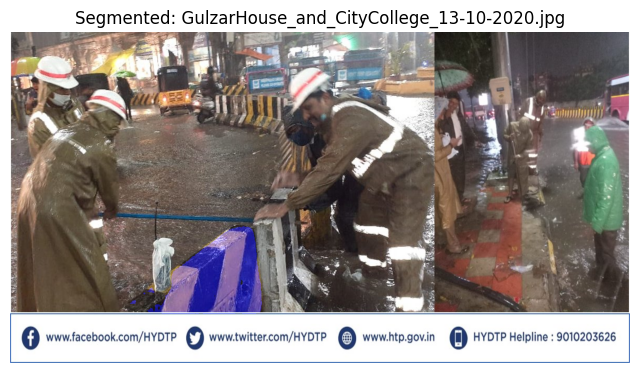


image 1/1 /content/UFID_Hyd/SM_JuniorCollege_Tolichowki_09-10-2020.jpg: 1024x1024 1 0, 284.6ms
Speed: 8.6ms preprocess, 284.6ms inference, 1.3ms postprocess per image at shape (1, 3, 1024, 1024)


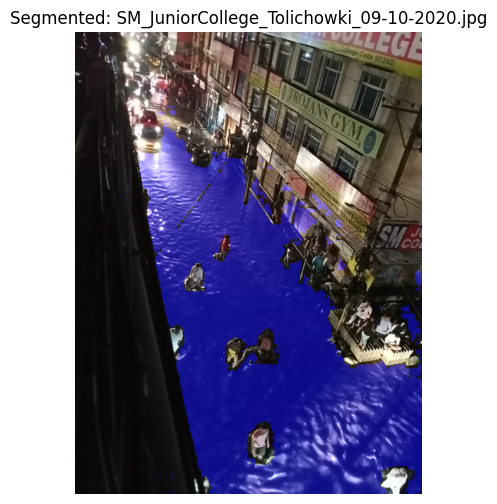


image 1/1 /content/UFID_Hyd/Kamalanagar_Chaitanyapuri_09-10-2020.jpg: 1024x1024 1 0, 278.9ms
Speed: 10.0ms preprocess, 278.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


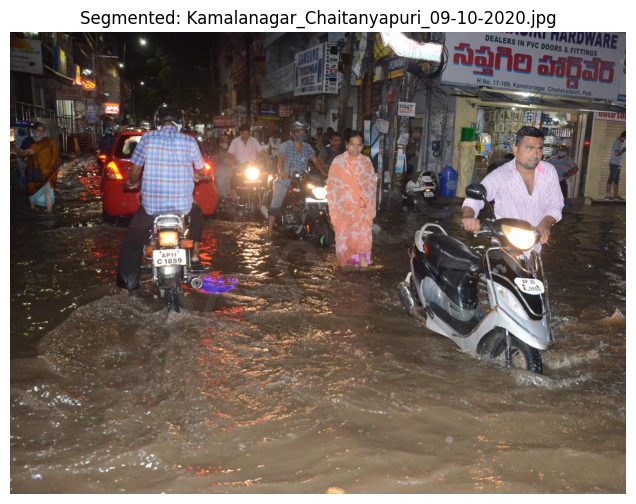


image 1/1 /content/UFID_Hyd/Pakeezah_Hotel_Kishanbagh_Division_09-10_2020.jpg: 1024x1024 1 0, 288.3ms
Speed: 11.6ms preprocess, 288.3ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


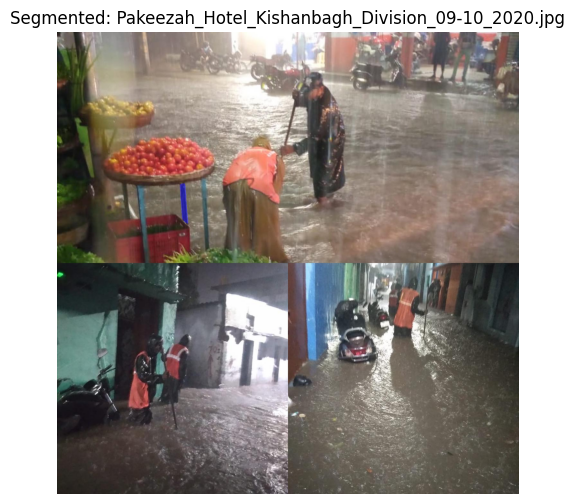


image 1/1 /content/UFID_Hyd/AkshayaHotel_Malakpet_13-10-2020.jpg: 1024x1024 1 0, 285.7ms
Speed: 9.9ms preprocess, 285.7ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


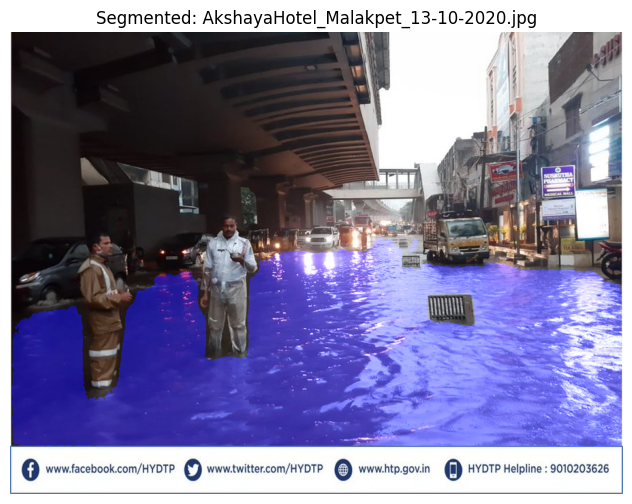


image 1/1 /content/UFID_Hyd/Khaiaratabad_Opposite_Bharat_PetroleumBunk_PillarNumber_A1179_09-10-2020.jpg: 1024x1024 1 0, 286.3ms
Speed: 9.4ms preprocess, 286.3ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


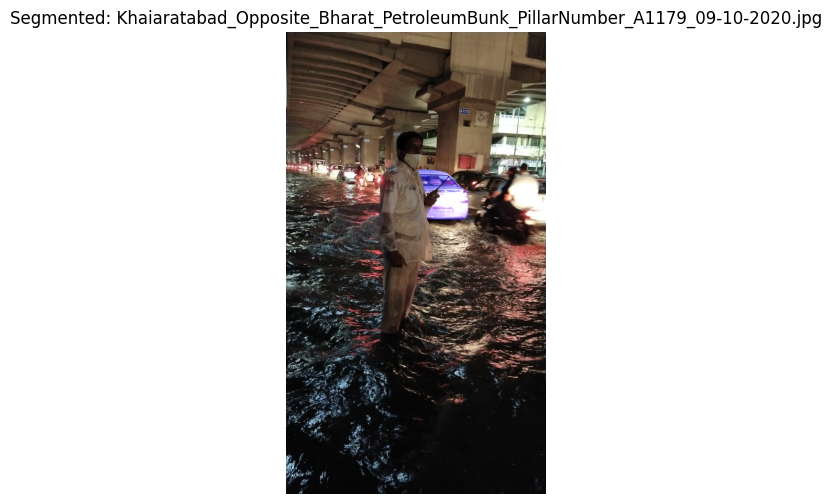


image 1/1 /content/UFID_Hyd/SaiNagarRoad-7_Lingojiguda_Saroornagar_13-10-2020.jpg: 1024x1024 1 0, 293.5ms
Speed: 9.3ms preprocess, 293.5ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


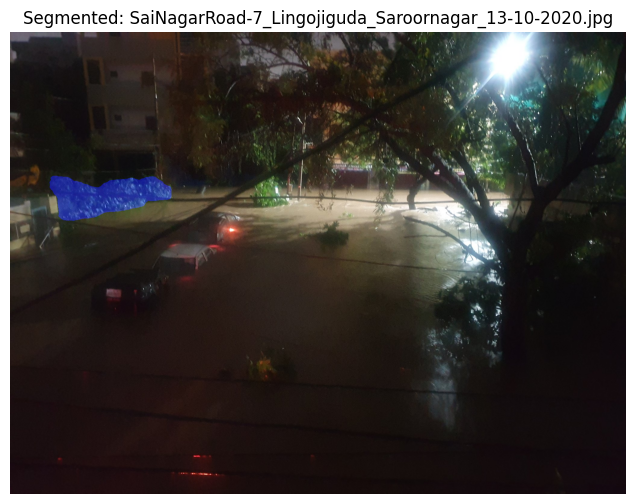


image 1/1 /content/UFID_Hyd/AttapurPillarNo193towardsDiaryFarm_09-10-2020.jpg: 1024x1024 1 0, 285.1ms
Speed: 13.3ms preprocess, 285.1ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


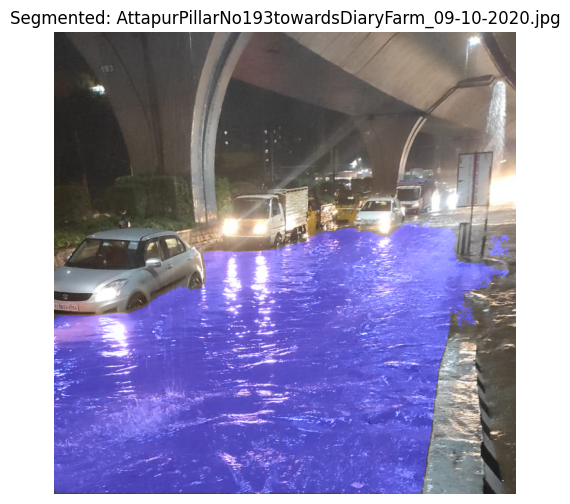


image 1/1 /content/UFID_Hyd/BadeMiyanKababs_Restaurant_Lakdikapul_13-10-2020.jpg: 1024x1024 1 0, 288.0ms
Speed: 14.3ms preprocess, 288.0ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


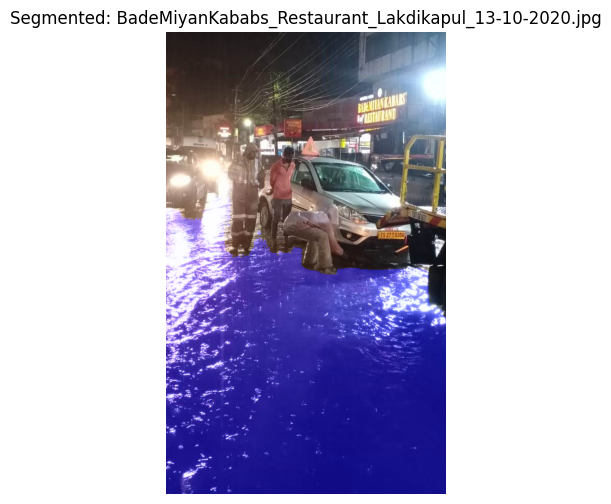


image 1/1 /content/UFID_Hyd/VirasathNagar_Towlichowki_09-10-2020_2.jpg: 1024x1024 1 0, 297.6ms
Speed: 8.1ms preprocess, 297.6ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


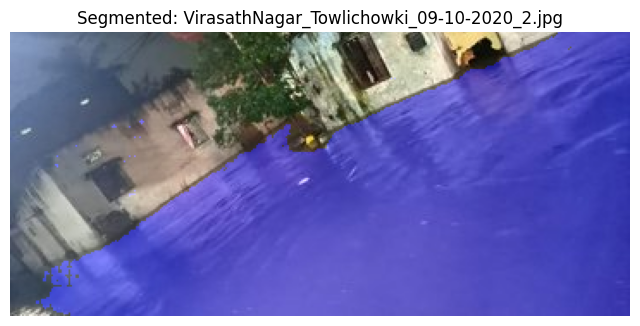


image 1/1 /content/UFID_Hyd/Moosapet_At_Dream_Modular_13to14-10-2020.jpg: 1024x1024 1 0, 305.5ms
Speed: 12.1ms preprocess, 305.5ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


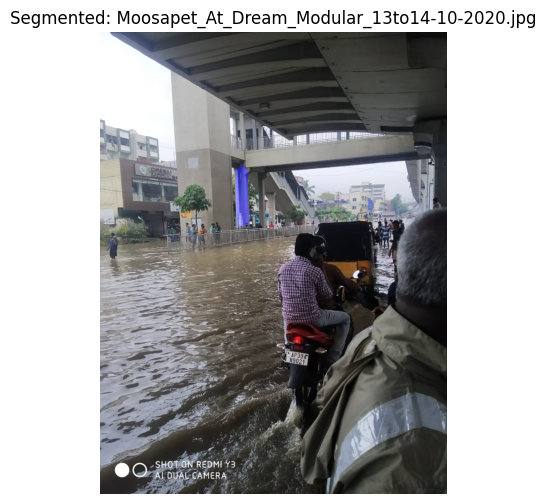


image 1/1 /content/UFID_Hyd/LBNagar_Circle_4_Raghavendra_Nagar_Meerpet_13-10-2020.jpg: 1024x1024 1 0, 287.8ms
Speed: 10.1ms preprocess, 287.8ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


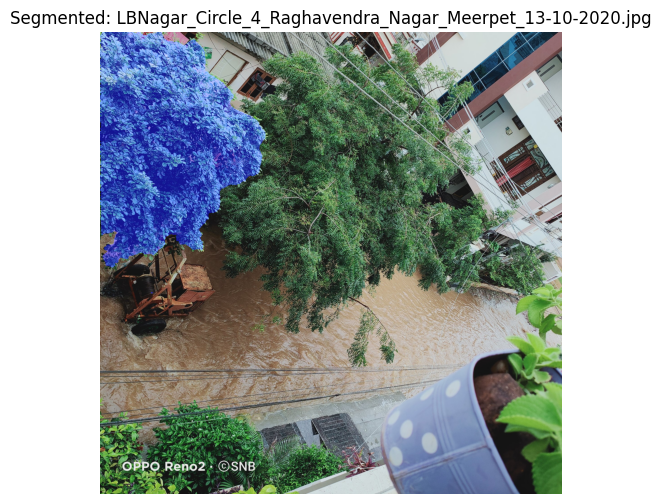


image 1/1 /content/UFID_Hyd/RambaghColony_Rajendranagar_09-10-2020.jpg: 1024x1024 1 0, 284.8ms
Speed: 6.7ms preprocess, 284.8ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


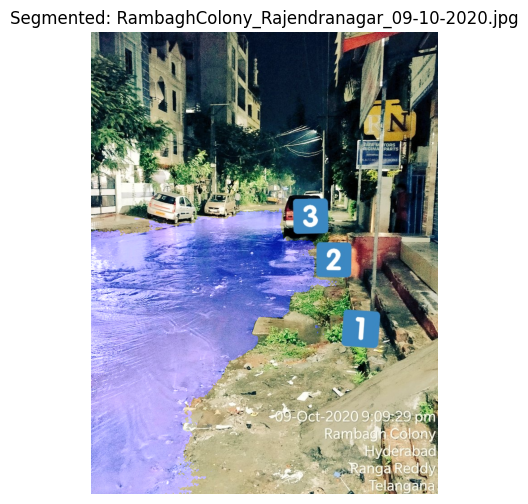


image 1/1 /content/UFID_Hyd/Gate_3_HighCourt_09-10-2020.jpg: 1024x1024 1 0, 284.0ms
Speed: 9.7ms preprocess, 284.0ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


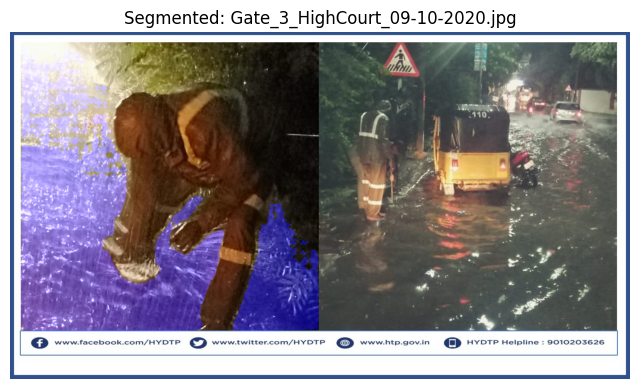


image 1/1 /content/UFID_Hyd/ChinnathokattaNala_Bowenpally_13to14-10-2020.jpg: 1024x1024 1 0, 283.6ms
Speed: 10.4ms preprocess, 283.6ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


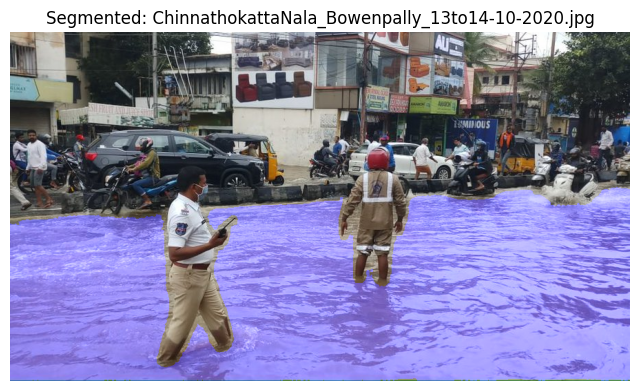


image 1/1 /content/UFID_Hyd/Yakutpura_GangaNagarNala_13-10-2020.jpg: 1024x1024 1 0, 286.3ms
Speed: 9.0ms preprocess, 286.3ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


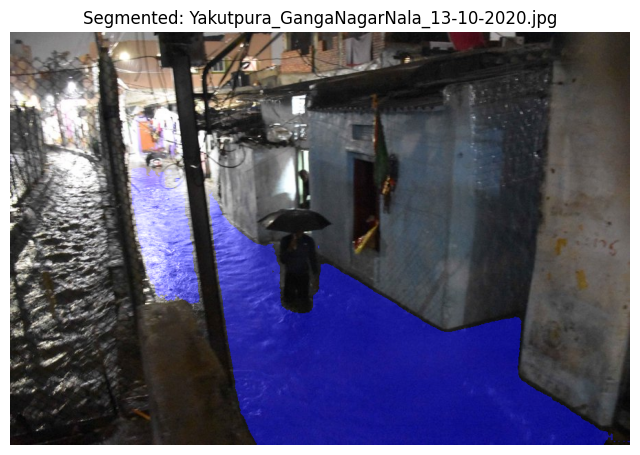


image 1/1 /content/UFID_Hyd/RailUnderBridge_Malakpet_13-10-2020.jpg: 1024x1024 1 0, 280.0ms
Speed: 9.2ms preprocess, 280.0ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


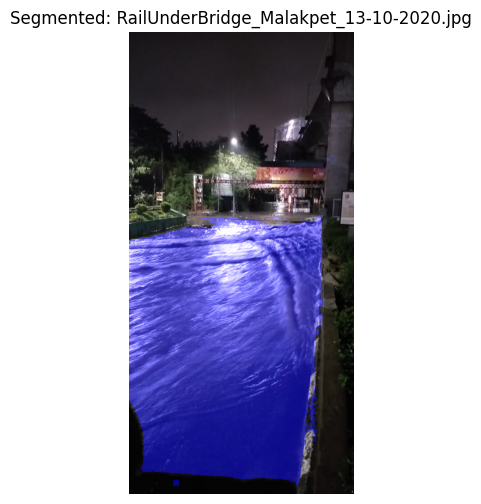


image 1/1 /content/UFID_Hyd/NadeemColony_Tolichowki_2_13-10-2020.jpg: 1024x1024 1 0, 285.7ms
Speed: 9.3ms preprocess, 285.7ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


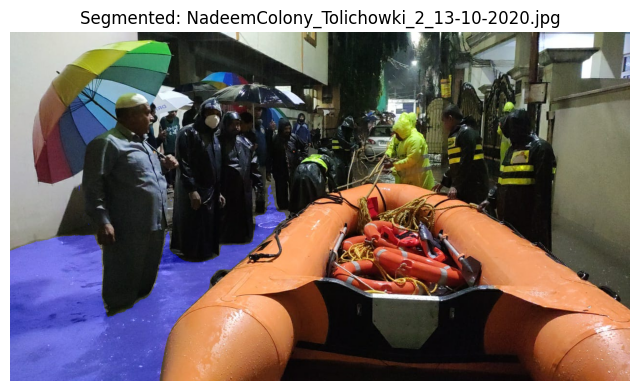


image 1/1 /content/UFID_Hyd/Chinnathokatta_Bowenpally_13to14-10-2020.jpg: 1024x1024 1 0, 374.2ms
Speed: 25.9ms preprocess, 374.2ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


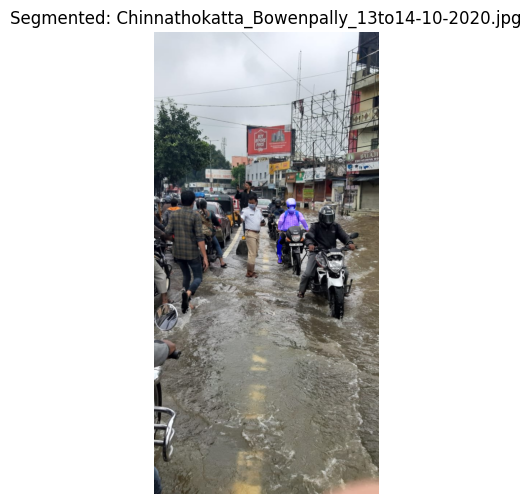


image 1/1 /content/UFID_Hyd/ShivamRoad_09-10-2020.jpg: 1024x1024 1 0, 408.7ms
Speed: 27.6ms preprocess, 408.7ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


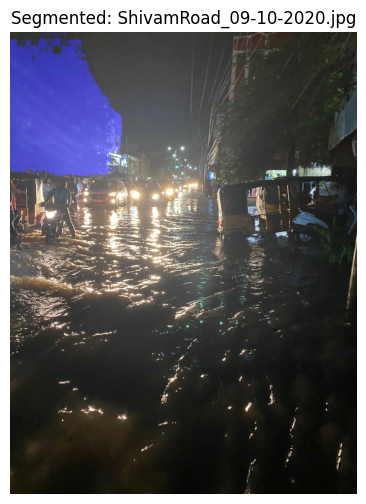


image 1/1 /content/UFID_Hyd/Khairatabad_Metro_Station_09-10-2020.jpg: 1024x1024 1 0, 281.4ms
Speed: 11.1ms preprocess, 281.4ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


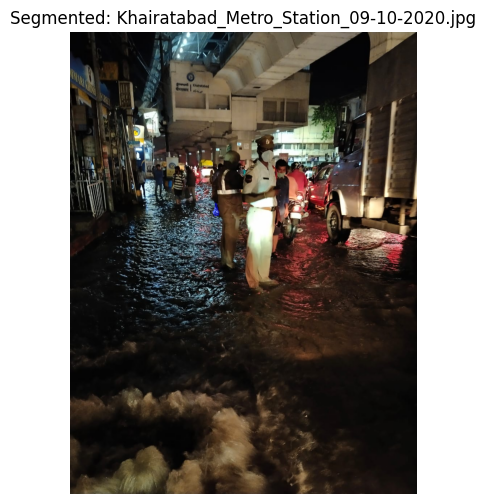


image 1/1 /content/UFID_Hyd/Riyan_Hotel_Mallepalli_Nampally_09-10-2020.jpg: 1024x1024 1 0, 277.8ms
Speed: 16.6ms preprocess, 277.8ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


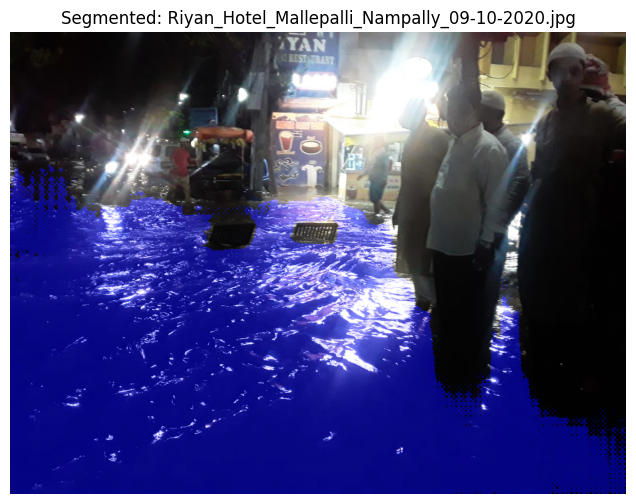


image 1/1 /content/UFID_Hyd/Asifnagar_DMart_13-10-2020.jpg: 1024x1024 1 0, 282.7ms
Speed: 11.6ms preprocess, 282.7ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


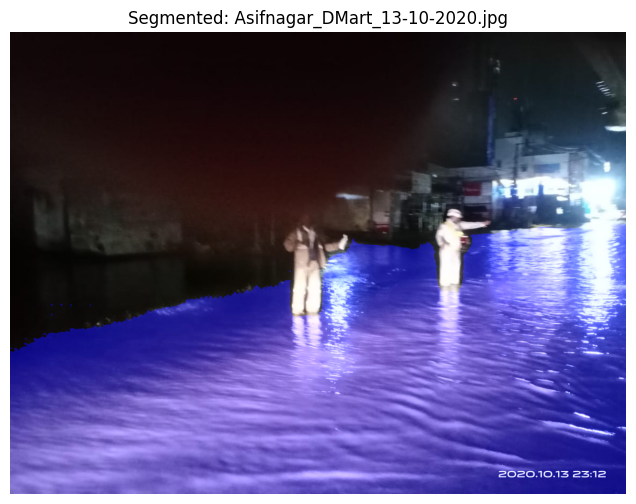


image 1/1 /content/UFID_Hyd/ChaitanyapuriRoad_MetroPlywood_13to14-10-2020.jpg: 1024x1024 1 0, 296.7ms
Speed: 11.3ms preprocess, 296.7ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


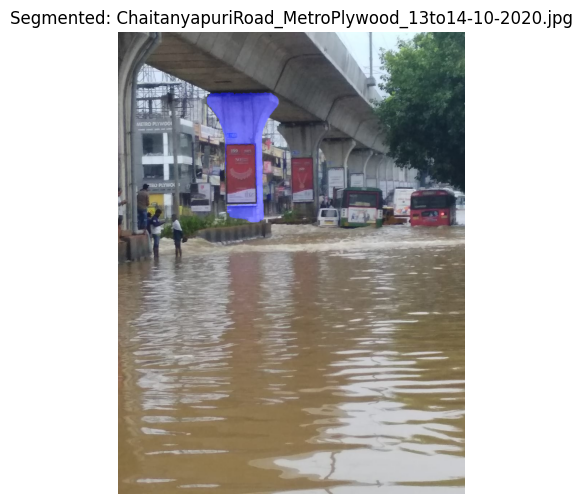


image 1/1 /content/UFID_Hyd/PetrolPump_Opposite_RajivGandhiStatue_Khairatabad.jpg: 1024x1024 1 0, 278.8ms
Speed: 8.5ms preprocess, 278.8ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


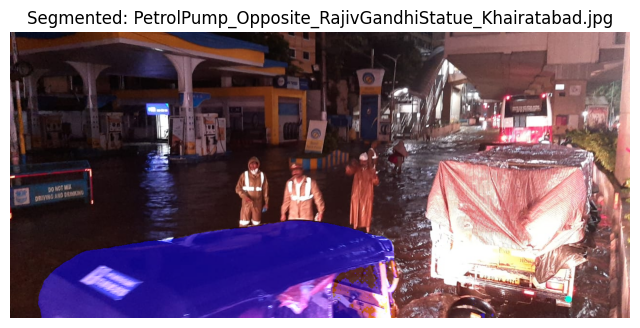


image 1/1 /content/UFID_Hyd/LimraHotel_Tolichowki_09-10-2020.jpg: 1024x1024 1 0, 281.0ms
Speed: 9.3ms preprocess, 281.0ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


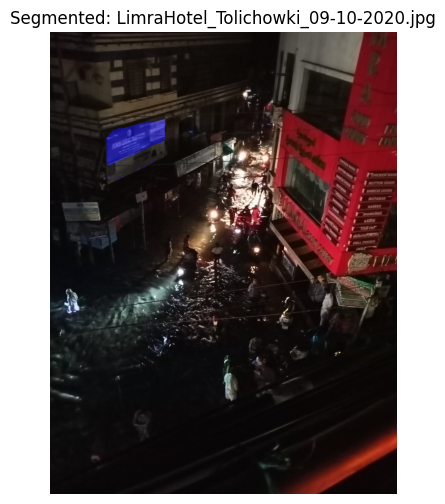


image 1/1 /content/UFID_Hyd/Necklace_Road_09-10-2020.jpg: 1024x1024 1 0, 285.7ms
Speed: 10.7ms preprocess, 285.7ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


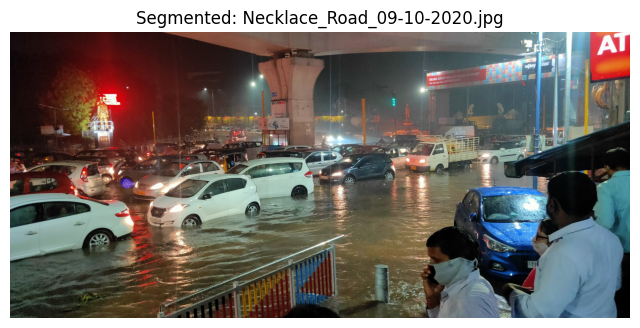


image 1/1 /content/UFID_Hyd/CRMP_Road_Khairatabad_Zone-1_09-10-2020.jpg: 1024x1024 1 0, 322.1ms
Speed: 17.6ms preprocess, 322.1ms inference, 6.0ms postprocess per image at shape (1, 3, 1024, 1024)


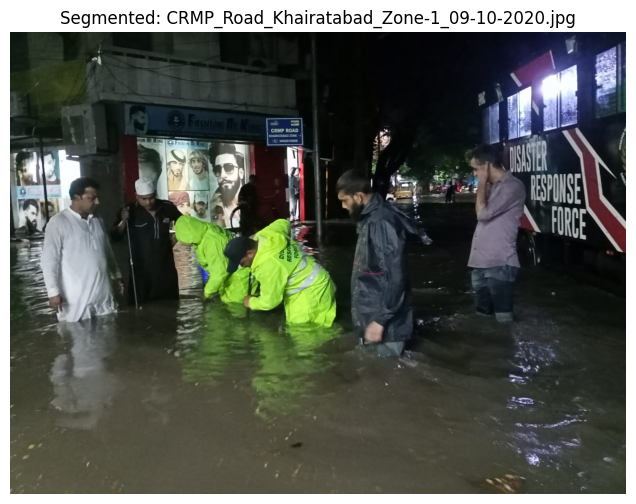


image 1/1 /content/UFID_Hyd/Oldage_home_ShankeshwarBazar_Saidabad_Saroornagar_13to14-10-2020.jpg: 1024x1024 1 0, 356.5ms
Speed: 38.8ms preprocess, 356.5ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


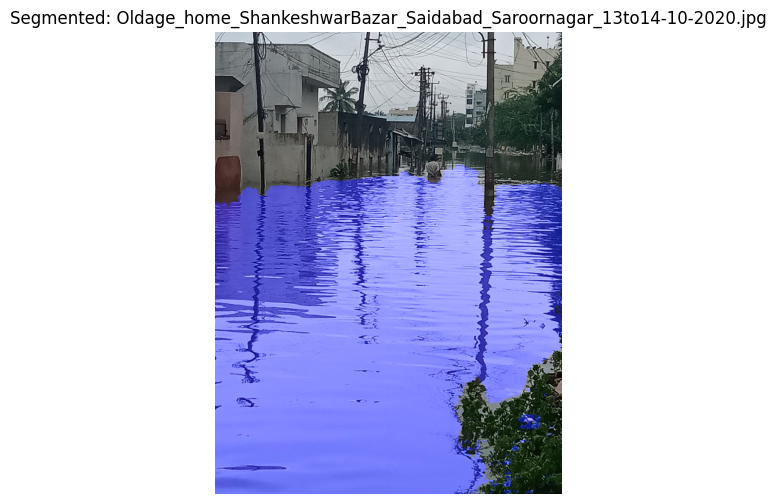


image 1/1 /content/UFID_Hyd/BahadurpuraJunction_13-10-2020.jpg: 1024x1024 1 0, 280.0ms
Speed: 13.1ms preprocess, 280.0ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)


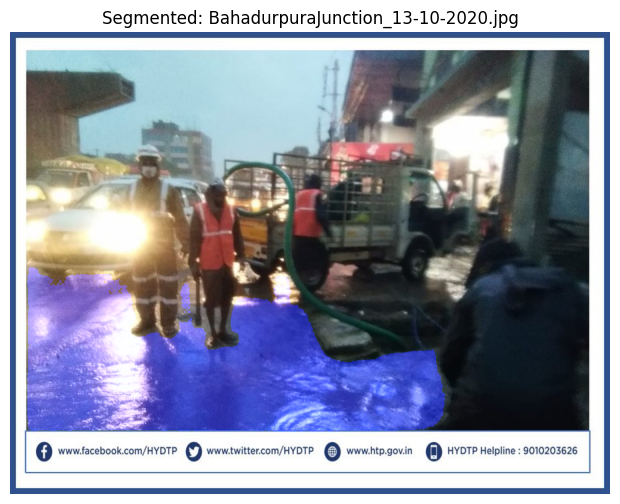

Processing complete! All images displayed.


In [17]:
from ultralytics import SAM
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Load the SAM 2.1 model
model = SAM("sam2.1_b.pt")

# Define the folder containing images
input_folder = "/content/UFID_Hyd"  # Change this to your folder path

# Define the point prompt (x, y) for object segmentation
point_prompt = [[400, 500]]  # Adjust coordinates based on your object of interest

# Process all images in the folder
image_files = [f for f in os.listdir(input_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

for image_name in image_files:
    image_path = os.path.join(input_folder, image_name)

    # Run inference with the point prompt
    results = model(image_path, points=point_prompt)

    # Load the original image
    original_image = np.array(Image.open(image_path).convert("RGB"))

    # Extract the segmentation mask
    mask = results[0].masks.data[0].cpu().numpy()  # Get the mask data

    # Convert mask to 3 channels (RGB) and scale values
    mask_colored = np.zeros_like(original_image)
    mask_colored[:, :, 2] = (mask * 255).astype(np.uint8)  # Blue mask

    # Blend the mask with the original image (No Bounding Box)
    alpha = 0.5  # Transparency factor
    overlay = cv2.addWeighted(original_image, 1, mask_colored, alpha, 0)

    # Display the segmented image with filename
    plt.figure(figsize=(8, 6))
    plt.imshow(overlay)
    plt.title(f"Segmented: {image_name}")  # Display filename
    plt.axis("off")  # Hide axes
    plt.show()

print("Processing complete! All images displayed.")


In [18]:
import os
import shutil

# Define source and destination directories
src_dir = "/content/UFID_Hyd/"
dst_dir = "/content/selected_images/"

# Create the destination directory if it doesn't exist
os.makedirs(dst_dir, exist_ok=True)

# List of images to move
image_list = [
    "Lakdikapul_Metro_Station_12-10-2020.jpg",
    "Nampally_RailwayStation_09-10-2020.jpg",
    "ChitraDargha_13-10-2020.jpg",
    "BanjaraHills_13to14-10-2020.jpg",
    "Khairatabad_RajivGandhiStatue_13-10-2020.jpg",
    "Hotel_Marjaan_VijayaNagarColony_Nampally_09-10-2020.jpg",
    "Puranapool_Graveyard_13-10-2020.jpg",
    "PetrolPump_OppRajivGandhiStatue_Khairatabad_Saifabad_09-10-2020.jpg",
    "MozzamjahiMarket_09-10-2020.jpg",
    "Allugaddabhavi_RailwayUnderBridge_Mettuguda_13-10-2020.jpg",
    "Malakpet_UnderBridge_09-10-2020.jpg",
    "VirasathNagar_Towlichowki_09-10-2020_3.jpg",
    "GulzarHouse_and_CityCollege_13-10-2020.jpg",
    "SM_JuniorCollege_Tolichowki_09-10-2020.jpg",
    "Kamalanagar_Chaitanyapuri_09-10-2020.jpg",
    "Pakeezah_Hotel_Kishanbagh_Division_09-10-2020.jpg",
    "AkshayaHotel_Malakpet_13-10-2020.jpg",
    "Khaiaratabad_Opposite_Bharat_PetroleumBunk_PillarNumber_A1179_09-10-2020.jpg",
    "SaiNagarRoad-7_Lingojiguda_Saroornagar_13-10-2020.jpg",
    "Moosapet_At_Dream_Modular_13to14-10-2020.jpg",
    "LBNagar_Circle_4_Raghavendra_Nagar_Meerpet_13-10-2020.jpg",
    "Gate_3_HighCourt_09-10-2020.jpg",
    "Chinnathokatta_Bowenpally_13to14-10-2020.jpg",
    "Khairatabad_Metro_Station_09-10-2020.jpg",
    "ChaitanyapuriRoad_MetroPlywood_13to14-10-2020.jpg",
    "PetrolPump_Opposite_RajivGandhiStatue_Khairatabad.jpg",
    "LimraHotel_Tolichowki_09-10-2020.jpg",
    "Necklace_Road_09-10-2020.jpg",
    "CRMP_Road_Khairatabad_Zone-1_09-10-2020.jpg"
]

# Move the images
for image in image_list:
    src_path = os.path.join(src_dir, image)
    dst_path = os.path.join(dst_dir, image)

    if os.path.exists(src_path):
        shutil.move(src_path, dst_path)
        print(f"Moved: {image}")
    else:
        print(f"File not found: {image}")

print("✅ All selected images have been moved to:", dst_dir)


Moved: Lakdikapul_Metro_Station_12-10-2020.jpg
Moved: Nampally_RailwayStation_09-10-2020.jpg
Moved: ChitraDargha_13-10-2020.jpg
Moved: BanjaraHills_13to14-10-2020.jpg
Moved: Khairatabad_RajivGandhiStatue_13-10-2020.jpg
Moved: Hotel_Marjaan_VijayaNagarColony_Nampally_09-10-2020.jpg
Moved: Puranapool_Graveyard_13-10-2020.jpg
Moved: PetrolPump_OppRajivGandhiStatue_Khairatabad_Saifabad_09-10-2020.jpg
Moved: MozzamjahiMarket_09-10-2020.jpg
Moved: Allugaddabhavi_RailwayUnderBridge_Mettuguda_13-10-2020.jpg
Moved: Malakpet_UnderBridge_09-10-2020.jpg
Moved: VirasathNagar_Towlichowki_09-10-2020_3.jpg
Moved: GulzarHouse_and_CityCollege_13-10-2020.jpg
Moved: SM_JuniorCollege_Tolichowki_09-10-2020.jpg
Moved: Kamalanagar_Chaitanyapuri_09-10-2020.jpg
File not found: Pakeezah_Hotel_Kishanbagh_Division_09-10-2020.jpg
Moved: AkshayaHotel_Malakpet_13-10-2020.jpg
Moved: Khaiaratabad_Opposite_Bharat_PetroleumBunk_PillarNumber_A1179_09-10-2020.jpg
Moved: SaiNagarRoad-7_Lingojiguda_Saroornagar_13-10-2020.jpg

# Remaining

### Multiple points prompt

Multiple `point_prompt` inputs refer to specific points (x, y) that serve as prompts to guide the Segment Anything Model (SAM) in segmenting multiple objects within an image.

In [ ]:
from ultralytics import SAM

# Load a model
model = SAM("sam2.1_b.pt")

# Run inference with multiple point prompts (Provide the points coordinates for
# person area, ensuring that only the person is segmented in the entire image)
results = model("https://ultralytics.com/images/bus.jpg",
                points=[[34, 714], [283, 634]])

# results[0].show()  # Display results


Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /content/bus.jpg: 1024x1024 1 0, 1 1, 315.8ms
Speed: 7.4ms preprocess, 315.8ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)


![Segment anything with multiple points prompt results](https://github.com/user-attachments/assets/fd7f7d78-f79b-401f-ad03-e129e8dc89dd)

## Auto Annotation using Segment Anything Model

[Auto-annotation](https://docs.ultralytics.com/reference/data/annotator/#ultralytics.data.annotator.auto_annotate) is a core feature of SAM, enabling users to create a segmentation dataset with a pre-trained detection model. It streamlines the annotation process by quickly and accurately labeling large image sets, eliminating the need for labor-intensive manual annotation.

- The example below uses two images from Ultralytics assets for auto-annotation, but you can use your own. Just create a folder, add the images you want to auto-annotate, and pass the folder path to the `auto_annotate` function via the `data` argument.

In [ ]:
from ultralytics.data.annotator import auto_annotate

# Use the Ultralytics sample dataset (You can use your own images)
from ultralytics.utils.downloads import safe_download
images = ["bus.jpg", "zidane.jpg"]
for img in images:
  path = safe_download(f"https://ultralytics.com/assets/{img}", dir="assets")

# return the annotation in the Ultralytics YOLO segmentation format.
# output directory i.e assets_auto_annotate_labels
auto_annotate(data="/content/assets",
              det_model="yolo11x.pt",
              sam_model="sam_b.pt")

100%|██████████| 134k/134k [00:00<00:00, 6.56MB/s]


100%|██████████| 49.2k/49.2k [00:00<00:00, 8.62MB/s]


100%|██████████| 109M/109M [00:00<00:00, 342MB/s]


100%|██████████| 358M/358M [00:01<00:00, 200MB/s]



image 1/2 /content/assets/bus.jpg: 640x480 4 persons, 1 bus, 71.2ms
image 2/2 /content/assets/zidane.jpg: 384x640 2 persons, 3 ties, 33.6ms
Speed: 2.8ms preprocess, 52.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


## Additional Resources  

🔹 Segment Anything 2 Documentation: [📖 Read here](https://docs.ultralytics.com/models/sam-2/)  
🔹 SAM2 Blog: [📝 Explore applications](https://www.ultralytics.com/blog/applications-of-meta-ai-segment-anything-model-2-sam-2)